Justin Dano <br>
FE550 - Data Visualization Applications <br>
Final Project

# Predicting Cryptocurrency Prices with News Sentiment

## Introduction

The value of cryptocurrencies, such as Bitcoin have been known to show wild fluctuations in price, and these price variations are far more volatile then any traditional financial asset in today's market. The aim of this project is to determine just how much do news articles impact the price of Bitcoin. To accomplish this goal, I will use data visualizations and perform sentiment analysis on a dataset of recent news article using Naive Bayes Classification.

The motivation for this project is to determine if news sentiment can be used to properly predict the price of cryptocurrencies. Another source of motivation is to try and understand the causes of such volatile price movements. Ultimately, if the ability to predict the future price of Bitcoin by news sentiment is plausible, it could be implemented into an investment strategy. While the project is currently focused on Bitcoin, it is quite easy to extend the functionality to other cryptocurrencies. The overall aim of this project is to attempt to answer the following research questions:


<b> 1. How does the news directly impact the immediate price of Bitcoin? </b><br>
<b> 2. Is the news the driving factor in how Bitcoin is priced? </b><br>
<b> 3. Can news sentiment be used to accurately predict the future price of Bitcoin?</b><br>


#### Technology Stack
Python 3.6.1 <br>
Anaconda 3-4.4.0 <br>
Pandas 0.20.3 <br>
NLTK 3.2.5<br>
Plotly 2.2.3 <br>
Developed on a Jupyter notebook.

<b>This project has three sections:</b>
<ul> 1. <b>Project Overview</b> - Goes over project structure and the work done on sentiment analysis </ul>
<ul> 2. <b>Visualizing the Impact of News Sentiment</b> - Graphs news sentiment with the price of Bitcoin </ul>
<ul> 3. <b>News Sentiment and Prediction</b> - Visualizations of how the Naive Bayes classifier predicts news sentiment </ul>

# 1. Project Overview

To begin, both Bitcoin data and news articles related to Bitcoin will need to be extracted. Next, some cleaning will needed to be done to both datasets before the sentiment of the news articles can be analyzed. For determining if a particular news article has positive or negative sentiment, the price of Bitcoin (at the time the article is published) is compared with the price of Bitcoin at a pre-defined offset time. This analysis uses an offset parameter of 1 minute after the article has been published. So if the price of Bitcoin has an up-tick one minute after the article was published, the article will be considered positive sentiment, and vice versa. To build the classifier, I used a naive Bayes classifier (from the NLTK library) based on the words from the description of each article (more on this in a minute). The results are saved as .csv file and finally used here in the Jupyter notebook for visualization.

Below I have included the general workflow of the project, with an additional summary for each component:

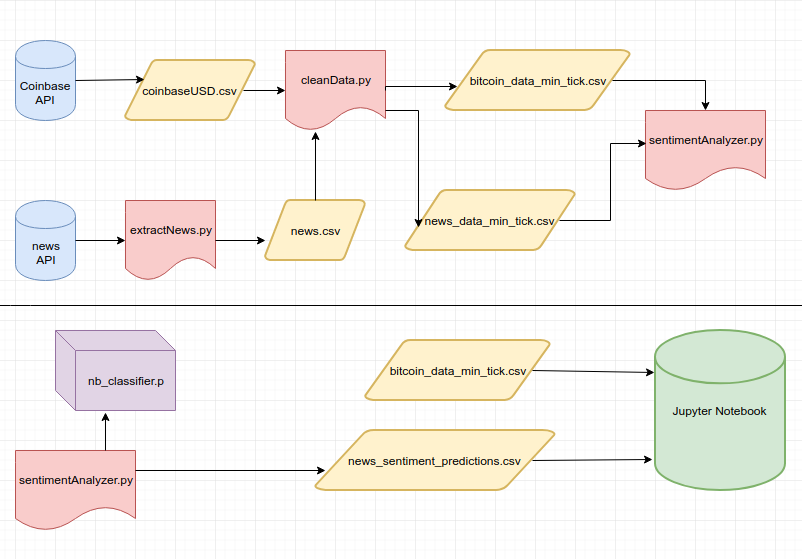

In [1]:
from IPython.display import Image
Image(filename='final_project_pipeline.png') 

### 1) API Usage

<ul><b>Coinbase API </b> - Easily obtainable Bitcoin data from https://bitcoincharts.com/ <br></ul>

<ul><b>News API </b> - A relatively new API for gathering news data for Python. Allows for pulling data from dozens of different sources and can filter based on topic. Also has the ability the sort the data returned by popularity and relevancy. The only caveat is the news data only goes back about three months. https://newsapi.org/ <br></ul>

### 2) News Articles Transformation

<ul><b>extractNews.py </b> -The first python script used for this project. It uses the news API to create the <i>news.csv</i> file. It extracts all the news related to the keyword 'Bitcoin' from September 8th, 2017 to November 20th, 2017. Since the news returns data in JSON, it does some work to transform it to .CSV format. <br></ul>

### 3) The Initial Data 

<ul><b>coinbaseUSD.csv </b> - CSV file pulled from the Coinbase API. It contains Bitcoin transactions with three features, including timestamp, price, and amount. This is the data used for building the Bitcoin price time series. <br></ul>
<ul><b>news.csv </b> - The .csv file created from the <i>extractNews.py</i> script. It contains Author, Source, Title, Description, published time, url, and url_image. <br></ul>

In [2]:
import pandas as pd
pd.read_csv('coinbaseUSD.csv', names=['timestamp', 'price', 'amount']).tail()

,timestamp,price,amount
25735922,1512259341,10921.23,9.100000e-07
25735923,1512259342,10921.23,6.389373e-02
25735924,1512259342,10921.23,4.750623e-01
25735925,1512259342,10921.23,4.123719e-01
25735926,1512259342,10921.23,2.715721e-01


In [3]:
pd.read_csv('news.csv', names=['author', 'description', 'popularity', 'published_at', 'source', 'title', 'url', 'url_image','nc', 'scraping_date']).tail()

,author,description,popularity,published_at,source,title,url,url_image,nc,scraping_date
7743,Becky Peterson,"Last week, a mistake by a novice hacker led to...",9996,2017-11-13T10:06:06Z,Business Insider,The amount of ether frozen in digital wallets ...,https://www.businessinsider.com/ethereum-price...,https://static.businessinsider.com/image/5a09f...,NC,2017-11-19 19:50:45.564220
7744,Will Martin,Good morning! Here's what you need to know in ...,9997,2017-11-15T19:51:51Z,Business Insider,10 things you need to know in markets today,https://www.businessinsider.com/10-things-euro...,https://static.businessinsider.com/image/5a0c1...,NC,2017-11-19 19:50:45.564220
7745,Becky Peterson,Everyone likes money. But technology that hand...,9998,2017-10-23T12:30:25Z,Business Insider,These 11 startups are reinventing how money wo...,https://www.businessinsider.com/from-sofi-to-c...,https://static.businessinsider.com/image/59ee6...,NC,2017-11-19 19:50:45.564220
7746,"David Glance, The Conversation",A rapidly growing number of companies are taki...,9999,2017-09-28T11:56:42Z,Businessinsider.com.au,Startups are starting to look at ICOs for funding,https://www.businessinsider.com.au/startups-ar...,https://edge.alluremedia.com.au/uploads/busine...,NC,2017-11-19 19:50:45.564220
7747,Peter Farquhar,Good morning. 1. North Korea's foreign ministe...,10000,2017-09-25T12:51:17Z,Businessinsider.com.au,10 things you need to know this morning in Aus...,https://www.businessinsider.com.au/10-things-y...,https://edge.alluremedia.com.au/uploads/busine...,NC,2017-11-19 19:50:45.564220


### 4) Cleaning and Preparing the Data for Naive Bayes Classification 
<ul><b>cleanData.py </b> - This script does some cleaning to prepare both the Bitcoin Price Data and News Sentiment data for Sentiment classification by Naive Bayes. It samples the Bitcoin data to minute-level frequency and takes only the subset of Bitcoin data needed for the news sentiment. The current coinbaseUSD contains over 25 million observations, so sampling is necessary for performance. <br></ul> 
<ul><b>bitcoin_data_min_tick.csv </b> - Subset of Bitcoin data between August to November 2017. It contains minute-level data of the Bitcoins price. Our domain has been reduced greatly, from 25 million to 100,000. Also the timestamp has been converted from the Unix timestamp. <br></ul>
<ul><b>news_data_min_tick.csv </b> - Clean and formatted news data ready for sentiment analysis. <br></ul>

In [4]:
pd.read_csv('bitcoin_data_min_tick.csv', names=['timestamp', 'price', 'amount']).tail()

,timestamp,price,amount
106557,2017-12-02 23:56:00,10931.11653846154,3.04175167
106558,2017-12-02 23:57:00,10931.338333333331,1.97673004
106559,2017-12-02 23:58:00,10931.339999999998,1.77948981
106560,2017-12-02 23:59:00,10931.263333333332,5.920019109999998
106561,2017-12-03 00:00:00,10930.233333333332,0.01309126


In [5]:
pd.read_csv('news_data_min_tick.csv').tail()

,published_at,author,source,title,description,url
7742,2017-11-20 00:01:00,Steve O'Hear,TechCrunch,Fintech startup Glint de-cloaks to offer a mul...,London-based Glint has been pretty stealthy ab...,https://techcrunch.com/2017/11/19/glint-in-my-...
7743,2017-11-20 00:16:00,SA Editor Stephen Alpher,Seekingalpha.com,Bitcoin cruises through $8K,Last weekend's plunge to about $5.5K is very m...,https://seekingalpha.com/news/3313378-bitcoin-...
7744,2017-11-20 00:20:00,Bethel,Brotherjohnf.com,Technical Scoop – Weekend Update Nov 19,news.goldseek.com / by David Chapman / 19 Nove...,http://www.brotherjohnf.com/technical-scoop-we...
7745,2017-11-20 00:29:00,HeidsterTrades,Seekingalpha.com,"Bitcoin, The Harmonic Gift From The Digital Gods",The price movement has been extremely technica...,https://seekingalpha.com/article/4126259-bitco...
7746,2017-11-20 00:30:00,Scott Jasper,Nationalinterest.org,"Russia and Ransomware: Stop the Act, Not the A...","Scott Jasper Security, Americas The problem wi...",http://nationalinterest.org/feature/russia-ran...


### 5) Performing Naive Bayes Classification 

The script <b>sentimentAnalyzer.py </b> is used to perform sentiment analysis on the news articles. Since the code is somewhat involved, and hundreds of lines long, I will leave it omitted here. For more info on Naive Bayes Classification, please visit [here](https://en.wikipedia.org/wiki/Naive_Bayes_classifier) or view the source code directly. I will speak in detail about how classification is done for this project however and also the general process for building the predictive model.

How do we determine what is positive sentiment or negative sentiment? Traditional NLTK packages have some libraries that can determine the sentiment accuracy with a good degree of accuracy, such as [Sentinet](http://sentiwordnet.isti.cnr.it/). For example, if an article has words like "good", "great, "awesome" it might be considered positive sentiment. 

This was not the approach I went with however, and instead I decided to build the classifier by comparing how the price of Bitcoin changed after a pre-determined time-frame. If the price of Bitcoin increased in price at the given time-frame, it is considered positive sentiment. If the price of Bitcoin decreased in price, it is considered negative sentiment. So the initial classification is done irrespective of the words in the actual article, but rather on how the price changed after the article was published. 

##### The general process for building the predictive model is:


<ol>i) First classify all news sentiment. This is done with a parameter time_offset_minutes.</ol>  

<ol>ii) Split the classified news data into equal segments of training and testing data </ol>
<ol>iii) Determine the Prior Probabilities of positive and negative news sentiment</ol>
<ol>iv) Define the vocabulary (using the training data). This is the list of all unique words in the training set.</ol>
<ol>v) Develop a method for feature extraction. This method will turn a news article into a feature vector (1's and 0's) that is the length of the vocabulary list. </ol>
<ol>vi) Feed the entire training set, along with the feature extraction method into NLTK. This will develop the Naive Bayes Classifier <i>nb_classifier.p</i>.</ol>
<ol>vii) Classify the testing dataset of news articles. Final output is <i>news_sentiment_predictions.csv</i></ol>


<b>Note: Sentiment and Prediction are the last columns of the dataframe</b>

In [6]:
pd.read_csv('news_sentiment_predictions.csv').tail()

,published_at,author,source,title,description,url,url_image,price,amount,next_price,sentiment,predicted
3775,2017-11-19 22:43:00,The Canadian Press,CBC News,Cryptocurrency is hot commodity as Bitcoin rea...,"Once purchased or mined, cryptocurrency lives ...",http://www.cbc.ca/news/canada/british-columbia...,https://i.cbc.ca/1.4116180.1494878984!/fileIma...,8024.005263,3.871707,8020.316744,-1.0,-1
3776,2017-11-20 00:16:00,SA Editor Stephen Alpher,Seekingalpha.com,Bitcoin cruises through $8K,Last weekend's plunge to about $5.5K is very m...,https://seekingalpha.com/news/3313378-bitcoin-...,https://static.seekingalpha.com/assets/og_imag...,8038.652000,4.832960,8033.024118,-1.0,1
3777,2017-11-20 00:20:00,Bethel,Brotherjohnf.com,Technical Scoop – Weekend Update Nov 19,news.goldseek.com / by David Chapman / 19 Nove...,http://www.brotherjohnf.com/technical-scoop-we...,http://www.goldseek.com/news/2017/11-19dc/imag...,8028.010435,2.377334,8028.008947,-1.0,-1
3778,2017-11-20 00:29:00,HeidsterTrades,Seekingalpha.com,"Bitcoin, The Harmonic Gift From The Digital Gods",The price movement has been extremely technica...,https://seekingalpha.com/article/4126259-bitco...,https://static1.seekingalpha.com/uploads/2017/...,8044.961154,2.558374,8044.908500,-1.0,1
3779,2017-11-20 00:30:00,Scott Jasper,Nationalinterest.org,"Russia and Ransomware: Stop the Act, Not the A...","Scott Jasper Security, Americas The problem wi...",http://nationalinterest.org/feature/russia-ran...,http://nationalinterest.org/files/main_images/...,8044.908500,2.098806,8044.907647,-1.0,1


# 2. Visualizing the Impact of News Sentiment

In [7]:
from plotly.offline import download_plotlyjs, init_notebook_mode, plot, iplot
import plotly.plotly as py
import plotly.graph_objs as go
from plotly import tools
init_notebook_mode(connected=True)

### Prepare and Combine Data for Visualizations 
The following cell is essentially doing a left join on the Bitcoin data with the news sentiment data. For a given timestamp, if a news article was published, include all the relevant details to the dataframe.

In [8]:
# Get Bitcoin Data
bitcoin_data = pd.read_csv('bitcoin_data_min_tick.csv')
bitcoin_data = bitcoin_data.set_index('timestamp', drop=False)

# Get News Articles that were part of Training Dataset 
training_news = pd.read_csv('training_news.csv')
training_news = training_news.set_index('published_at', drop=False)
# Format sentiment (float -> Int)
training_news.sentiment = training_news.sentiment.astype(int)
bitcoin_data['article_published'] = 0

# Adds news data to rows (timestamps) that also have an article published
bitcoin_data.loc[training_news.index, 'article_published'] = 1
bitcoin_data.loc[training_news.index, 'sentiment'] = training_news.sentiment
bitcoin_data.loc[training_news.index, 'title'] = training_news.title
bitcoin_data.loc[training_news.index, 'url'] = training_news.url
bitcoin_data.loc[training_news.index, 'source'] = training_news.source
bitcoin_data.loc[training_news.index, 'author'] = training_news.author

bitcoin_data.head()

,timestamp,price,amount,article_published,sentiment,title,url,source,author
timestamp,,,,,,,,,
2017-09-20 00:00:00,2017-09-20 00:00:00,3904.247397,17.092184,1,-1.0,Mining Ethereum on Ubuntu with a GTX 1070,https://insights.ubuntu.com/2017/09/20/mining-...,Ubuntu.com,Joshua Powers
2017-09-20 00:01:00,2017-09-20 00:01:00,3900.008125,1.852407,0,NaN,NaN,NaN,NaN,NaN
2017-09-20 00:02:00,2017-09-20 00:02:00,3900.005556,6.136684,0,NaN,NaN,NaN,NaN,NaN
2017-09-20 00:03:00,2017-09-20 00:03:00,3900.009231,0.582816,0,NaN,NaN,NaN,NaN,NaN
2017-09-20 00:04:00,2017-09-20 00:04:00,3900.006250,4.445870,0,NaN,NaN,NaN,NaN,NaN


### Method for Plotting Dynamic Data Visualization

In [9]:
def plot_bitcoin_and_sentiment_range(sentiment, start_day, end_day=None):
    title = None
    legend_name = None
    sentiment_color = None

    # Setup the title and colors based on sentiment and end_day parameter
    if sentiment == 1:
        if end_day is None:
            title = 'Price of Bitcoin on {} with Positive News Sentiment'.format(start_day)
        else:
            title = 'Price of Bitcoin between {} and {} with Positive News Sentiment'.format(start_day, end_day)
         
        legend_name = 'Positive News'
        sentiment_color = 'green'
    elif sentiment == -1:
        if end_day is None:
            title = 'Price of Bitcoin on {} with Negative News Sentiment'.format(start_day)
        else:
            title = 'Price of Bitcoin between {} and {} with Negative News Sentiment'.format(start_day, end_day)
            
        legend_name = 'Negative News'
        sentiment_color = 'red'
    
        
    # Filter bitcoin time-series based on date
    if end_day is None:
        plot_bitcoin_data = bitcoin_data[bitcoin_data['timestamp'].str.contains(start_day)]
    else:
        plot_bitcoin_data = bitcoin_data[(bitcoin_data['timestamp'] >= start_day) 
                                         & (bitcoin_data['timestamp'] <= end_day)]

    # Plot Bitcoins Price
    trace0 = go.Scatter(
        x=plot_bitcoin_data.timestamp, 
        y=plot_bitcoin_data.price, 
        name='USD/BTC')

    # Specifically used to plot the news articles on the time series
    news_sentiment = plot_bitcoin_data[plot_bitcoin_data['sentiment'] == sentiment]

    # Plot Points of News Articles
    trace1 = go.Scatter(
        x=news_sentiment.timestamp, 
        y=news_sentiment.price, 
        mode='markers',
        name=legend_name,
        marker = dict(size=5,line = dict(width=1),color=sentiment_color),
        hoverinfo='none',
        textposition='top')


    # Plot news Info
    trace2 = go.Scatter(
        x=news_sentiment.timestamp,
        y=[min(plot_bitcoin_data.price) - 10]*len(news_sentiment.timestamp),
        text='Title: ' + news_sentiment.loc[news_sentiment.timestamp]['title'] + '<br>' +
             'Source: ' + news_sentiment.loc[news_sentiment.timestamp]['source'] + '<br>' +
             'Author: ' + news_sentiment.loc[news_sentiment.timestamp]['author'],
        showlegend=False,
        marker = dict(color=sentiment_color)
    )

    plot_data = [trace0, trace1, trace2]
    
    plot_layout = go.Layout(title=title, 
                            titlefont=dict(family='Courier New, monospace', size=20),
                            xaxis=dict(
                                title='Time', 
                                titlefont=dict(family='Courier New, monospace',size=18)),
                            yaxis=dict(
                                title='USD/BTC', 
                                titlefont=dict(family='Courier New, monospace',size=18))
                           )
    
    fig = dict(data=plot_data, layout=plot_layout)
    iplot(fig)

The entire history of news sentiment is between September 21st, 2017 and November 11th, 2017. This is largely due to the limitations from the newsAPI. For our training data, our universe is between September 21st and October 23rd. Our first two visualizations are the entire universe of training data for both negative and positive news sentiment.

In [10]:
 plot_bitcoin_and_sentiment_range(-1, '2017-09-21', '2017-10-23')

In [11]:
plot_bitcoin_and_sentiment_range(1, '2017-09-21', '2017-10-23')

While these graphs put may put you in the Christmas spirit, they don't really provide any useful information. Essentially the size of the graph will not work with the amount of news articles published. Lucky for us, the method was made in such a way where scaling down on specific days can be done via the method call. By analyzing a specific day, we can learn a lot more about the news sentiment.

In [12]:
plot_bitcoin_and_sentiment_range(-1, '2017-10-12')

Each dot on the time-series represents a news article that experienced a corresponding down-tick in Bitcoin Price. What makes this classifier somewhat bad is the arbitrary choice of 1 minute after the article is released. Take for example the article around at 7:35am, titled "The Blockchain Intersection with Supply Chain Data". The initial price did decreased after the article was released, but only to be followed by a huge spike in price. One might speculate that this article was actually positive sentiment, and was simply considering the wrong time frame. Another possible solution is that another news article was released with positive sentiment shortly after the one with negative sentiment. Let us look at the same day, but filter on positive sentiment.  

In [13]:
plot_bitcoin_and_sentiment_range(1, '2017-10-12')

As suspected, there indeed is another news article prior to the huge spike at around 8:00am. Unfortunately, we can not conclude that the article directly impacted the price swing. A better approach would be to look and see if any patterns emerge with when news articles are published and how the change in price occurs. While not perfect, it does appear that positive news sentiment can be found before most price hikes. Next we will combine the articles from both negative and positive sentiment to get a more clear picture of how news may be affecting the price of Bitcoin.

### Combining Positive and Negative Sentiment 

In [14]:
def plot_bitcoin_and_both_sentiment_range(start_day, end_day=None):
    if end_day is None:
        title = 'Price of Bitcoin on {} with News Sentiment'.format(start_day)
    else:
        title = 'Price of Bitcoin between {} and {} with News Sentiment'.format(start_day, end_day)
       
    # Filter bitcoin time-series based on date
    if end_day is None:
        plot_bitcoin_data = bitcoin_data[bitcoin_data['timestamp'].str.contains(start_day)]
    else:
        plot_bitcoin_data = bitcoin_data[(bitcoin_data['timestamp'] >= start_day) 
                                         & (bitcoin_data['timestamp'] <= end_day)]

    # Plot Bitcoins Price
    trace0 = go.Scatter(
        x=plot_bitcoin_data.timestamp, 
        y=plot_bitcoin_data.price, 
        name='USD/BTC')

    # Specifically used to plot the news articles on the time series
    pos_news_sentiment = plot_bitcoin_data[plot_bitcoin_data['sentiment'] == 1]
    neg_news_sentiment = plot_bitcoin_data[plot_bitcoin_data['sentiment'] == -1]
    
    # Plot Points of News Articles
    pos_trace = go.Scatter(
        x=pos_news_sentiment.timestamp, 
        y=pos_news_sentiment.price, 
        mode='markers',
        name='Positive News',
        marker = dict(size=5,line = dict(width=1),color='green'),
        hoverinfo='none',
        textposition='top')

    
    # Plot Points of News Articles
    neg_trace = go.Scatter(
        x=neg_news_sentiment.timestamp, 
        y=neg_news_sentiment.price, 
        mode='markers',
        name='Negative News',
        marker = dict(size=5,line = dict(width=1),color='red'),
        hoverinfo='none',
        textposition='top')
       
    # Plot news Info
    all_news = pd.concat([pos_news_sentiment, neg_news_sentiment])
    
    # Plot Positive news Info
    news_info = go.Scatter(
        x=all_news.timestamp,
        y=[min(plot_bitcoin_data.price) - 10]*len(all_news.timestamp),
        text='Title: ' + all_news.loc[all_news.timestamp]['title'] + '<br>' +
             'Source: ' + all_news.loc[all_news.timestamp]['source'] + '<br>' +
             'Author: ' + all_news.loc[all_news.timestamp]['author'],
        showlegend=False,
        marker = dict(color='#1F77B4')
    )
    
    
    plot_data = [trace0, pos_trace, neg_trace, news_info]
    
    plot_layout = go.Layout(title=title, 
                            titlefont=dict(family='Courier New, monospace', size=20),
                            xaxis=dict(
                                title='Time', 
                                titlefont=dict(family='Courier New, monospace',size=18)),
                            yaxis=dict(
                                title='USD/BTC', 
                                titlefont=dict(family='Courier New, monospace',size=18))
                           )
    
    fig = dict(data=plot_data, layout=plot_layout)
    iplot(fig)

Now with both positive and negative sentiment plotted on the time-series, a complete picture can be visualize and how different news articles may impact the change in price. I have included a few samples below.

In [15]:
plot_bitcoin_and_both_sentiment_range('2017-10-12')

In [16]:
plot_bitcoin_and_both_sentiment_range('2017-10-13')

In [17]:
plot_bitcoin_and_both_sentiment_range('2017-10-13', '2017-10-18')

# 3. News Sentiment and Prediction

All previous visualizations were of the training data used to create the Naive Bayes Classifier. Now let us visualize the results of predicting the sentiment of news articles.

In [18]:
news_data_with_predictions = pd.read_csv('news_sentiment_predictions.csv')
news_data_with_predictions = news_data_with_predictions.set_index('published_at', drop=False)
news_data_with_predictions.sentiment = news_data_with_predictions.sentiment.astype(int)

bitcoin_data = pd.read_csv('bitcoin_data_min_tick.csv')
bitcoin_data = bitcoin_data.set_index('timestamp', drop=False)

# Combine Bitcoin Data with News Sentiment
bitcoin_data['article_published'] = 0

bitcoin_data.loc[news_data_with_predictions.index, 'article_published'] = 1
bitcoin_data.loc[news_data_with_predictions.index, 'sentiment'] = news_data_with_predictions.sentiment
bitcoin_data.loc[news_data_with_predictions.index, 'predicted'] = news_data_with_predictions.predicted
bitcoin_data.loc[news_data_with_predictions.index, 'title'] = news_data_with_predictions.title
bitcoin_data.loc[news_data_with_predictions.index, 'source'] = news_data_with_predictions.source
bitcoin_data.loc[news_data_with_predictions.index, 'author'] = news_data_with_predictions.author

### Visualizing Sentiment Predictions

In [19]:
def plot_bitcoin_and_predicted_sentiment(side, start_day, end_day=None):

    if end_day is None:
        title = 'Price of Bitcoin on {} with Predicted News Sentiment'.format(start_day)
    else:
        title = 'Price of Bitcoin between {} and {} with Predicted News Sentiment'.format(start_day, end_day)

 
    sentiment_color='green'
 
       
    # Filter bitcoin time-series based on date
    if end_day is None:
        plot_bitcoin_data = bitcoin_data[bitcoin_data['timestamp'].str.contains(start_day)]
    else:
        plot_bitcoin_data = bitcoin_data[(bitcoin_data['timestamp'] >= start_day) 
                                         & (bitcoin_data['timestamp'] <= end_day)]        


    # Specifically used to plot the news articles on the time series
    news_sentiment = plot_bitcoin_data[plot_bitcoin_data['article_published'] == 1]
    if side == 'correct':
        symbol='0'
        pos_sentiment = news_sentiment[(news_sentiment.predicted == 1) & (news_sentiment.sentiment == 1)]
        neg_sentiment = news_sentiment[(news_sentiment.predicted == -1) & (news_sentiment.sentiment == -1)]
        pos_title = 'Correctly Predicted Positive Sentiment'
        neg_title = 'Correctly Predicted Negative Sentiment'
    elif side == 'incorrect':
        symbol='x'
        pos_sentiment = news_sentiment[(news_sentiment.predicted == 1) & (news_sentiment.sentiment != 1)]
        neg_sentiment = news_sentiment[(news_sentiment.predicted == -1) & (news_sentiment.sentiment != -1)]
        pos_title = 'Incorrectly Predicted Positive Sentiment'
        neg_title = 'Incorrectly Predicted Negative Sentiment'        
        
    # Plot Bitcoins Price
    bitcoin_price_trace = go.Scatter(
        x=plot_bitcoin_data.timestamp, 
        y=plot_bitcoin_data.price, 
        name='USD/BTC')

    # Plot positive sentiment points that were correct (green O)
    pos_trace = go.Scatter(
        x=pos_sentiment.timestamp, 
        y=pos_sentiment.price, 
        mode='markers',
        name=pos_title,
        marker = dict(symbol=symbol, size=7, line = dict(width=1),color='green'),
        hoverinfo='none')
  

    # Plot negative sentiment points that were correct (red O)
    neg_trace = go.Scatter(
        x=neg_sentiment.timestamp, 
        y=neg_sentiment.price, 
        mode='markers',
        name=neg_title,
        marker = dict(symbol=symbol, size=7, line = dict(width=1),color='red'),
        hoverinfo='none')
  
    
    # Plot news Info
    all_news = pd.concat([pos_sentiment, neg_sentiment])
    
    news_info_trace = go.Scatter(
        x=all_news.timestamp,
        y=[min(plot_bitcoin_data.price) - 10]*len(all_news.timestamp),
        text='Title: ' + all_news.loc[all_news.timestamp].title + '<br>' + 
             'Source: ' + all_news.loc[all_news.timestamp].source + '<br>' +
             'Author: ' + all_news.loc[all_news.timestamp].author + '<br>' +
             'Actual Sentiment: ' + all_news.loc[all_news.timestamp].sentiment.astype(str) + '<br>' +
             'Predicted Sentiment: ' + all_news.loc[all_news.timestamp].predicted.astype(str),
        showlegend=False,
        marker = dict(color='#1F77B4')
    )
    
    plot_data = [bitcoin_price_trace, pos_trace, neg_trace, news_info_trace]
    
    plot_layout = go.Layout(title=title, 
                            titlefont=dict(family='Courier New, monospace', size=20),
                            xaxis=dict(
                                title='Time', 
                                titlefont=dict(family='Courier New, monospace',size=18)),
                            yaxis=dict(
                                title='USD/BTC', 
                                titlefont=dict(family='Courier New, monospace',size=18))
                           )
    
    fig = dict(data=plot_data, layout=plot_layout)
    iplot(fig)

Now we have a similar method as before, but this time we will only be visualizing correct or incorrect news sentiment predictions. I have included a few samples below, first over a period of a few days, followed by a specific analysis of October 24th.

In [20]:
plot_bitcoin_and_predicted_sentiment('correct', '2017-10-25', '2017-11-01')

Now let us examine the same timeframe for news sentiment that was incorrectly predicted.

In [21]:
plot_bitcoin_and_predicted_sentiment('incorrect', '2017-10-25', '2017-11-01')

As before, its somewhat difficult to gain an intuition of the news sentiment based on the relative size of the graph and number of data points. So for now we will focus on one day, October 24th, 2017 for analysis.

In [22]:
plot_bitcoin_and_predicted_sentiment('correct', '2017-10-24')

While not perfect, it does appear that most articles are typically placed right near huge changes in price. Even if the sentiment is not completely accurate, it does go to show that news can indeed impact the immediate price of Bitcoin. Now let us examine some incorrect predictions.

In [23]:
plot_bitcoin_and_predicted_sentiment('incorrect', '2017-10-24')

As with the training data. It is somewhat hard to see the whole picture without the entire domain of news articles incorporated into the visualization. Our final visualization will combine all sentiment predictions in one visualization.

### Comparing All Sentiment

In [24]:
def plot_bitcoin_and_predicted_sentiment(start_day, end_day=None):

    if end_day is None:
        title = 'Price of Bitcoin on {} with Predicted News Sentiment'.format(start_day)
    else:
        title = 'Price of Bitcoin between {} and {} with Predicted News Sentiment'.format(start_day, end_day)

 
       
    # Filter bitcoin time-series based on date
    if end_day is None:
        plot_bitcoin_data = bitcoin_data[bitcoin_data['timestamp'].str.contains(start_day)]
    else:
        plot_bitcoin_data = bitcoin_data[(bitcoin_data['timestamp'] >= start_day) 
                                         & (bitcoin_data['timestamp'] <= end_day)]        


    # Specifically used to plot the news articles on the time series
    news_sentiment = plot_bitcoin_data[plot_bitcoin_data['article_published'] == 1]
    pos_cor_sentiment = news_sentiment[(news_sentiment.predicted == 1) & (news_sentiment.sentiment == 1)]
    pos_incor_sentiment = news_sentiment[(news_sentiment.predicted == 1) & (news_sentiment.sentiment != 1)]
    neg_cor_sentiment = news_sentiment[(news_sentiment.predicted == -1) & (news_sentiment.sentiment == -1)]
    neg_incor_sentiment = news_sentiment[(news_sentiment.predicted == -1) & (news_sentiment.sentiment != -1)]
    
    
    # Plot Bitcoins Price
    bitcoin_price_trace = go.Scatter(
        x=plot_bitcoin_data.timestamp, 
        y=plot_bitcoin_data.price, 
        name='USD/BTC')

    # Plot positive sentiment points that were correct (green O)
    pos_correct_trace = go.Scatter(
        x=pos_cor_sentiment.timestamp, 
        y=pos_cor_sentiment.price, 
        mode='markers',
        name='Correctly Predicted Positive Sentiment',
        marker = dict(size=7, line = dict(width=1),color='green'),
        hoverinfo='none')
  
    # Plot positive sentiment points that were incorrect (green x)
    pos_incorrect_trace = go.Scatter(
        x=pos_incor_sentiment.timestamp, 
        y=pos_incor_sentiment.price, 
        mode='markers',
        name='Incorrectly Predicted Positive Sentiment',
        marker = dict(symbol="x", size=7, line = dict(width=1), color='green'),
        hoverinfo='none')

    # Plot negative sentiment points that were correct (red O)
    neg_correct_trace = go.Scatter(
        x=neg_cor_sentiment.timestamp, 
        y=neg_cor_sentiment.price, 
        mode='markers',
        name='Correctly Predicted Negative Sentiment',
        marker = dict(size=7, line = dict(width=1),color='red'),
        hoverinfo='none')
  
    # Plot positive sentiment points that were incorrect (red x)
    neg_incorrect_trace = go.Scatter(
        x=neg_incor_sentiment.timestamp, 
        y=neg_incor_sentiment.price, 
        mode='markers',
        name='Incorrectly Predicted Negative Sentiment',
        marker = dict(symbol="x", size=7, line = dict(width=1), color='red'),
        hoverinfo='none')    
    
    
    # Plot news Info
    news_info_trace = go.Scatter(
        x=news_sentiment.timestamp,
        y=[min(plot_bitcoin_data.price) - 10]*len(news_sentiment.timestamp),
        text='Title: ' + news_sentiment.loc[news_sentiment.timestamp].title + '<br>' + 
             'Source: ' + news_sentiment.loc[news_sentiment.timestamp].source + '<br>' +
             'Author: ' + news_sentiment.loc[news_sentiment.timestamp].author + '<br>' +
             'Actual Sentiment: ' + news_sentiment.loc[news_sentiment.timestamp].sentiment.astype(str) + '<br>' +
             'Predicted Sentiment: ' + news_sentiment.loc[news_sentiment.timestamp].predicted.astype(str),
        showlegend=False,
        marker = dict(color='#1F77B4')
    )
    
    plot_data = [bitcoin_price_trace, 
                 pos_correct_trace, pos_incorrect_trace, 
                 neg_correct_trace, neg_incorrect_trace,
                 news_info_trace]
    
    plot_layout = go.Layout(title=title, 
                            titlefont=dict(family='Courier New, monospace', size=20),
                            xaxis=dict(
                                title='Time', 
                                titlefont=dict(family='Courier New, monospace',size=18)),
                            yaxis=dict(
                                title='USD/BTC', 
                                titlefont=dict(family='Courier New, monospace',size=18))
                           )
    
    fig = dict(data=plot_data, layout=plot_layout)
    iplot(fig)

In [25]:
plot_bitcoin_and_predicted_sentiment('2017-10-24')

In [26]:
plot_bitcoin_and_predicted_sentiment('2017-10-30')

## Conclusion
After reviewing the visualizations above, I find it hard to believe that the current naives classifier has good predicting power. It appears that there are just as many X's (incorrect predictions) as there are O's (correct predictions). To verify, I build a method to determine the actual accuracy of the classifier. The statistics shown below are the results from the Naive Bayes Classifier. Overall its prediction power was only 51.64%. An interesting find is that it was a lot better at predicting positive sentiment, 58.54% compared to negative sentiment, a mere 43.67%. 

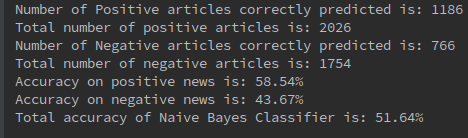

In [27]:
Image(filename='naiveBayes_results.png') 

### Obstacles

One of the main obstacles of this project was figuring out a way to provide reproducible interactivity. Initially I had plans to make this an interactive visualization where the user can make choices and provide a unique data visualization. Unfortunately, once the Jupyter notebook is exported to HTML, all widgets and event listeners are converted to static code, altering them useless. The alternative was having the end user download the .ipynb file and installing all the dependent python modules needed and to run the notebook. This seemed like too much work, and decided to create a product that could be completely rendered in HTML. If I was to do this all over, I would of used a completely different technology stack for interactive visualizations, such as an RShiny application or a full-blown web-app in D3.

### Future Work

1) One improvement would be to develop a full naive-Bayes classifier by extracting the entire article (instead of just the description). This was my initial design but building a classifier by scratch with the entire set of words from each article would take an enormous amount of processing power. Also the scraper I designed keep running into issues extracting HTML from various sites, returning HTTP Error codes.

2) Further work could also be done on how the actual news was classified. I believe my approach was somewhat rudimentary (choosing the price differential one minute after the article was published). 

3) I had only touched the surface with the NEWS API. There was so much flexibility in what type of news can be scraped, and the topic I chose was only related to Bitcoin. Future work could be done to extend the news to several different keywords for various Cryptocurrencies.

4) Also the Bitcoin data was only focused on one exchange, Coinbase (GDAX). Future work would extend this functionality for multiple exchanges, and even different cryptocurrencies.

5) And Finally, no real profit-analysis was done on the prediction model of Naive Bayes. To implement the sentiment analysis into an actual investment strategy, a trading strategy would need to be developed based on the signals of the classifier and finally analysis on the actual P/L would need to be done.

### References: 
    (1) https://newsapi.org/account
    (2) https://bitcoincharts.com/
    (3) https://ahmedbesbes.com/how-to-mine-newsfeed-data-and-extract-interactive-insights-in-python.html
    (4) https://www.pluralsight.com/courses/building-sentiment-analysis-systems-python
